In [1]:
import sys
if not '../..' in sys.path:
    sys.path.append('../..')

In [2]:

from analysis import collection, analysis, plot

from pathlib import Path

import numpy as np
from scipy.optimize import curve_fit

import matplotlib.pyplot as plt
from matplotlib import animation
from matplotlib.collections import LineCollection
from matplotlib.colors import to_rgba
from IPython.display import HTML

image_folder = Path("/Users/spencer/phd/phd/images/")
image_path = image_folder / Path("basic_results")

%matplotlib inline

# visualize a few trajectories from a given trial

/Users/spencer/phd/phd/analysis/notebooks/basic_results/../../analysis/plot.py:129: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "ko" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(
/Users/spencer/phd/phd/analysis/notebooks/basic_results/../../analysis/plot.py:129: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ko" (-> color='k'). The keyword argument will take precedence.
  ax.plot(


Text(0.5, 0, 'Worst Performer')

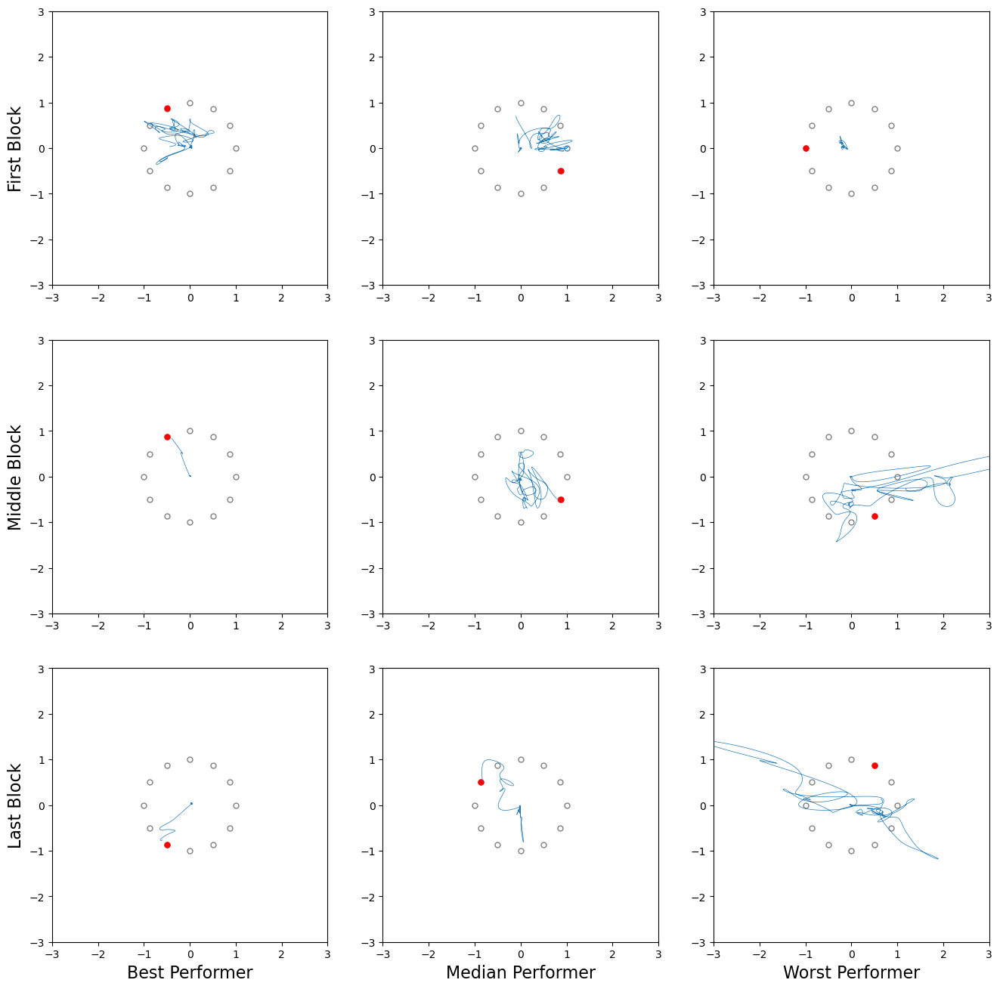

In [3]:
collection_name = "emg_olympics"
task_name = "center_hold"
session_name = "session_1"

subjects = ["morio", "holly", "hyewon"]

behavior_fig, axes = plt.subplots(3,3, figsize=(16,16))
for ax in axes.flatten():
    ax.set_xlim([-3,3])
    ax.set_ylim([-3,3])

sessions = [0,22,44]
for col, subject_name in enumerate(subjects):
    for row in range(3):
        s = collection.Session(collection_name, subject_name, task_name, f"session_{sessions[row]}")
        if subject_name == "hyewon":
            trial_number = 7
        else:
            trial_number = 1
        trial = s.sorted_trials()[trial_number]
        trial.get_trajectory()
        t = trial.trajectory
        target_loc = [s.outcome_array[trial_number][-2], s.outcome_array[trial_number][-1]]
        plot.plot_targets(axes[row,col], target=target_loc)
        axes[row,col].plot(t[:,-2],t[:,-1], linewidth=0.5)

axes[0,0].set_ylabel("First Block", fontsize=16)
axes[1,0].set_ylabel("Middle Block", fontsize=16)
axes[2,0].set_ylabel("Last Block", fontsize=16)
axes[2,0].set_xlabel("Best Performer", fontsize=16)
axes[2,1].set_xlabel("Median Performer", fontsize=16)
axes[2,2].set_xlabel("Worst Performer", fontsize=16)

In [4]:
plot.save_figure(behavior_fig, "example_trajectories", image_folder / "methods")
# behavior_fig.savefig("/Users/spencer/motor-control/thesis/images/data_analysis2023/behavior.pdf", dpi=300, format="pdf")

Figure saved to /Users/spencer/phd/phd/images/methods/example_trajectories.pdf


In [5]:
subjects = analysis.load_subjects()

In [25]:
# from matplotlib.collections import LineCollection
# miss_cmap = plt.colormaps['Blues']
# hit_cmap = plt.colormaps['Reds']
# color_start = 0
# color_stop = 1
# target_num = 4
# fig, ax = plt.subplots(1,1,figsize=(15,15))
# hit_line_collects = []
# miss_line_collects = []
# for trial in trials:
#     if trial.target_number == target_num:
#         trial.get_trajectory()
#         traj = trial.trajectory[:,-2:]
#         segs = [(traj[i,:], traj[i+1,:]) for i in range(traj.shape[0]-1)]
#         if trial.outcome == "Hit":
#             hit_line_collects.append(LineCollection(segs, array=np.linspace(color_start, color_stop, traj.shape[0]), cmap=hit_cmap, linewidths=2, alpha=np.linspace(.1,1,len(segs)+1)))
#             # ax.add_collection(lines)
#         elif trial.outcome == "Miss":
#             miss_line_collects.append(LineCollection(segs, array=np.linspace(color_start, color_stop, traj.shape[0]), cmap=miss_cmap, linewidths=2, alpha=np.linspace(.1,1,len(segs)+1)))
#             # ax.add_collection(lines)
# ax.plot([0],[1],'k*',markersize=20)
# ax.set_xlim([-2,2])
# ax.set_ylim([-2,2])

## trajectory into a list of tuples

In [ ]:
def make_segments(trial):
    trial.get_trajectory()
    traj = trial.trajectory[:,-2:]
    return [(traj[i,:], traj[i+1,:]) for i in range(traj.shape[0]-1)]

# animation of trials

In [8]:
# target_num = 4
# subject_num = 0
# trials = []
# for sesh in subjects[subject_num].tasks["center_hold"].sorted_sessions():
#     trials.extend(sesh.sorted_trials())

# all_segments = []
# all_colors = []
# for trial in trials:
#     if trial.target_number == target_num:
#         segments = make_segments(trial)
#         all_segments.append(segments)
#         if trial.outcome == "Hit":
#             all_colors.append([to_rgba("tab:blue")[:3] + (0.1,) for _ in segments])
#         elif trial.outcome == "Miss":
#             all_colors.append([to_rgba("tab:red")[:3] + (0.1,) for _ in segments])

# anim_fig = plt.figure(figsize=(10,10))
# anim_ax = plt.axes(xlim=(-2, 2), ylim=(-2, 2))
# anim_ax.set_yticks([])
# anim_ax.set_xticks([])
# line = LineCollection([])
# anim_ax.add_collection(line)
# analysis.plot_targets(anim_ax, markersize=35)

# def animate(i, line):
#     if i == 0:
#         return line

#     segments = []
#     colors = []
#     for segs, cs in zip(all_segments[:i], all_colors[:i]):
#         segments.extend(segs)
#         colors.extend(cs)

#     # update alpha
#     for j in range(len(all_colors[i-1])):
#         colors[-j] = colors[-j][:3] + (1.0,)

#     line.set_segments(segments)
#     line.set_color(colors)
#     return line

# anim = animation.FuncAnimation(anim_fig, animate, fargs=[line], frames=len(all_segments), interval=2000)
# anim_fig.tight_layout()
# HTML(anim.to_jshtml())

/Users/spencer/phd/phd/analysis/notebooks/../analysis/analysis.py:93: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "ko" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(np.cos(theta), np.sin(theta), style, marker=m, markersize=markersize, color="grey")
/Users/spencer/phd/phd/analysis/notebooks/../analysis/analysis.py:93: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ko" (-> color='k'). The keyword argument will take precedence.
  ax.plot(np.cos(theta), np.sin(theta), style, marker=m, markersize=markersize, color="grey")


In [9]:
with open("trials.html", "w") as f:
    print(anim.to_html5_video(), file=f)

## single subject, all trials

/Users/spencer/phd/phd/analysis/notebooks/basic_results/../../analysis/plot.py:129: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "ko" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(
/Users/spencer/phd/phd/analysis/notebooks/basic_results/../../analysis/plot.py:129: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ko" (-> color='k'). The keyword argument will take precedence.
  ax.plot(


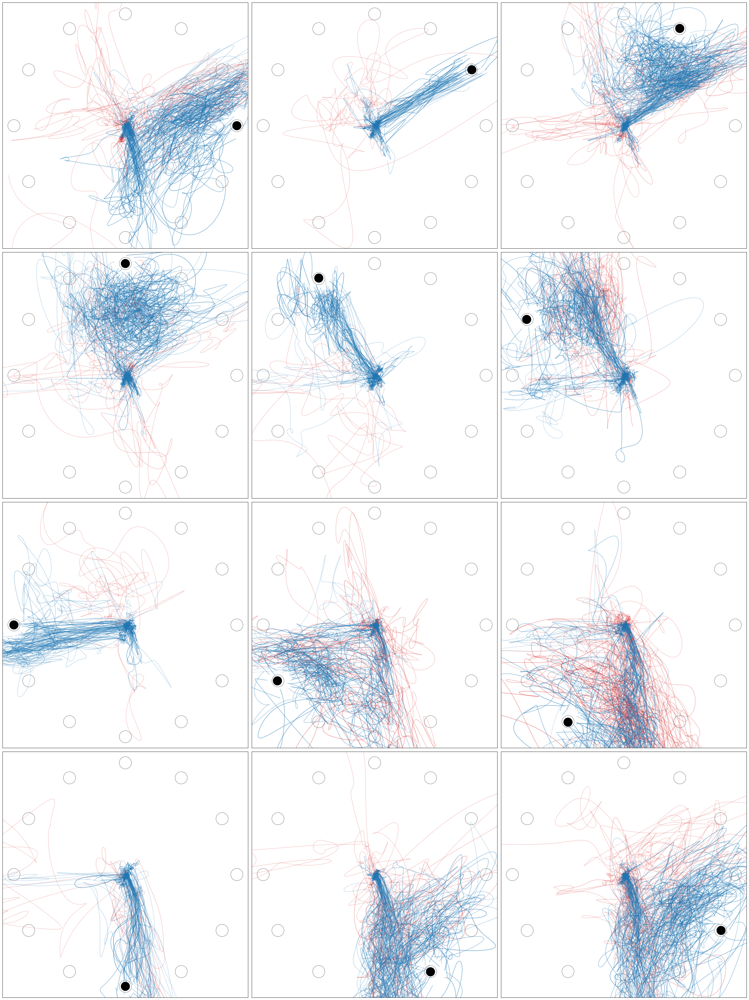

: 

In [30]:
# for si in range(len(subjects)):
si = 6
trials = []
for sesh in subjects[si].tasks["center_hold"].sorted_sessions():
    trials.extend(sesh.sorted_trials())

fig, axes = plt.subplots(4,3,figsize=(30,40))
for i, ax in enumerate(axes.ravel()):
    target_num = i+1
    ax.set_yticks([])
    ax.set_xticks([])
    line = LineCollection([])
    ax.add_collection(line)
    plot.plot_targets(ax, markersize=35)

    segments = []
    colors = []
    alphas = np.linspace(0.2, 0.6, len(trials))
    for trial, alpha in zip(trials, alphas):
        if trial.target_number == target_num:
            segs = make_segments(trial)
            segments.extend(segs)
            if trial.outcome == "Hit":
                colors.extend([to_rgba("tab:red")[:3] + (alpha,) for _ in segs])
            elif trial.outcome == "Miss":
                colors.extend([to_rgba("tab:green")[:3] + (alpha,) for _ in segs])

    line.set_segments(segments)
    line.set_color(colors)
    tar_vec = collection.compute_target_vec_from_number(target_num)
    ax.plot(tar_vec[0],tar_vec[1],"ko",markersize=25)
_ = fig.tight_layout()
# fig.savefig(image_path / f"trajectories/trajectories_subject_{si}.pdf", dpi=300, format="pdf")

In [11]:
from pypdf import PdfMerger

pdfs = list((image_path / "trajectories").iterdir())
pdfs.sort()

merger = PdfMerger()

for pdf in pdfs:
    merger.append(pdf)

merger.write(image_path / "trajectories/all_subjects.pdf")
merger.close()